<a href="https://colab.research.google.com/github/jacobjmorra/neuralnets_project/blob/main/projects/fMRI/load_hcp_task_with_behaviour.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Load HCP parcellated task data
## (version with Behavioural Data)

The HCP dataset comprises task-based fMRI from a large sample of human subjects. The NMA-curated dataset includes time series data that has been preprocessed and spatially-downsampled by aggregating within 360 regions of interest.

In order to use this dataset, please electronically sign the HCP data use terms at [ConnectomeDB](https://db.humanconnectome.org). Instructions for this are on pp. 24-25 of the [HCP Reference Manual](https://www.humanconnectome.org/storage/app/media/documentation/s1200/HCP_S1200_Release_Reference_Manual.pdf).

In this notebook, NMA provides code for downloading the data and doing some basic visualisation and processing.

In [39]:
# @title Install dependencies
!pip install nilearn --quiet

In [40]:
import os
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [41]:
#@title Figure settings
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
plt.style.use("https://raw.githubusercontent.com/NeuromatchAcademy/course-content/main/nma.mplstyle")

In [42]:
# The data shared for NMA projects is a subset of the full HCP dataset
N_SUBJECTS = 100

# The data have already been aggregated into ROIs from the Glasser parcellation
N_PARCELS = 360

# The acquisition parameters for all tasks were identical
TR = 0.72  # Time resolution, in seconds

# The parcels are matched across hemispheres with the same order
HEMIS = ["Right", "Left"]

# Each experiment was repeated twice in each subject
RUNS   = ['LR','RL']
N_RUNS = 2

# There are 7 tasks. Each has a number of 'conditions'
# TIP: look inside the data folders for more fine-graned conditions

EXPERIMENTS = {
    'MOTOR'      : {'cond':['lf','rf','lh','rh','t','cue']},
    'WM'         : {'cond':['0bk_body','0bk_faces','0bk_places','0bk_tools','2bk_body','2bk_faces','2bk_places','2bk_tools']},
    'EMOTION'    : {'cond':['fear','neut']},
    'GAMBLING'   : {'cond':['loss','win']},
    'LANGUAGE'   : {'cond':['math','story']},
    'RELATIONAL' : {'cond':['match','relation']},
    'SOCIAL'     : {'cond':['ment','rnd']}
}

> For a detailed description of the tasks have a look pages 45-54 of the [HCP reference manual](https://www.humanconnectome.org/storage/app/media/documentation/s1200/HCP_S1200_Release_Reference_Manual.pdf).

# Downloading data

The task data are shared in different files, but they will unpack into the same directory structure.


In [43]:
# @title Download data file
import os, requests

fname = "hcp_task.tgz"
url = "https://osf.io/2y3fw/download"

if not os.path.isfile(fname):
  try:
    r = requests.get(url)
  except requests.ConnectionError:
    print("!!! Failed to download data !!!")
  else:
    if r.status_code != requests.codes.ok:
      print("!!! Failed to download data !!!")
    else:
      with open(fname, "wb") as fid:
        fid.write(r.content)

In [44]:
# The download cells will store the data in nested directories starting here:
HCP_DIR = "./hcp_task"

# importing the "tarfile" module
import tarfile

# open file
with tarfile.open(fname) as tfile:
  # extracting file
  tfile.extractall('.')

subjects = np.loadtxt(os.path.join(HCP_DIR, 'subjects_list.txt'), dtype='str')

/tmp/ipython-input-2825554391.py:10: DeprecationWarning: Python 3.14 will, by default, filter extracted tar archives and reject files or modify their metadata. Use the filter argument to control this behavior.
  tfile.extractall('.')


## Understanding the folder organisation

The data folder has the following organisation:

- hcp
  - regions.npy (information on the brain parcellation)
  - subjects_list.txt (list of subject IDs)
  - subjects (main data folder)
    - [subjectID] (subject-specific subfolder)
      - EXPERIMENT (one folder per experiment)
        - RUN (one folder per run)
          - data.npy (the parcellated time series data)
          - EVs (EVs folder)
            - [ev1.txt] (one file per condition)
            - [ev2.txt]
            - Stats.txt (behavioural data [where available] - averaged per run)
            - Sync.txt (ignore this file)



## Loading region information

Downloading this dataset will create the `regions.npy` file, which contains the region name and network assignment for each parcel.

Detailed information about the name used for each region is provided [in the Supplement](https://static-content.springer.com/esm/art%3A10.1038%2Fnature18933/MediaObjects/41586_2016_BFnature18933_MOESM330_ESM.pdf) to [Glasser et al. 2016](https://www.nature.com/articles/nature18933).

Information about the network parcellation is provided in [Ji et al, 2019](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6289683/).



In [45]:
regions = np.load(f"{HCP_DIR}/regions.npy").T
region_info = dict(
    name=regions[0].tolist(),
    network=regions[1],
    hemi=['Right']*int(N_PARCELS/2) + ['Left']*int(N_PARCELS/2),
)

# Help functions

We provide two helper functions: one for loading the time series from a single suject and a single run, and one for loading an EV file for each task.

An EV file (EV:Explanatory Variable) describes the task experiment in terms of stimulus onset, duration, and amplitude. These can be used to model the task time series data.

In [46]:
def load_single_timeseries(subject, experiment, run, remove_mean=True):
  """Load timeseries data for a single subject and single run.

  Args:
    subject (str):      subject ID to load
    experiment (str):   Name of experiment
    run (int):          (0 or 1)
    remove_mean (bool): If True, subtract the parcel-wise mean (typically the mean BOLD signal is not of interest)

  Returns
    ts (n_parcel x n_timepoint array): Array of BOLD data values

  """
  bold_run  = RUNS[run]
  bold_path = f"{HCP_DIR}/subjects/{subject}/{experiment}/tfMRI_{experiment}_{bold_run}"
  bold_file = "data.npy"
  ts = np.load(f"{bold_path}/{bold_file}")
  if remove_mean:
    ts -= ts.mean(axis=1, keepdims=True)
  return ts


def load_evs(subject, experiment, run):
  """Load EVs (explanatory variables) data for one task experiment.

  Args:
    subject (str): subject ID to load
    experiment (str) : Name of experiment
    run (int): 0 or 1

  Returns
    evs (list of lists): A list of frames associated with each condition

  """
  frames_list = []
  task_key = f'tfMRI_{experiment}_{RUNS[run]}'
  for cond in EXPERIMENTS[experiment]['cond']:
    ev_file  = f"{HCP_DIR}/subjects/{subject}/{experiment}/{task_key}/EVs/{cond}.txt"
    ev_array = np.loadtxt(ev_file, ndmin=2, unpack=True)
    ev       = dict(zip(["onset", "duration", "amplitude"], ev_array))
    # Determine when trial starts, rounded down
    start = np.floor(ev["onset"] / TR).astype(int)
    # Use trial duration to determine how many frames to include for trial
    duration = np.ceil(ev["duration"] / TR).astype(int)
    # Take the range of frames that correspond to this specific trial
    frames = [s + np.arange(0, d) for s, d in zip(start, duration)]
    frames_list.append(frames)

  return frames_list

# Example run

Let's load the timeseries data for the MOTOR experiment from a single subject and a single run

In [47]:
my_exp = 'MOTOR'
my_subj = subjects[1]
my_run = 1

data = load_single_timeseries(subject=my_subj,
                              experiment=my_exp,
                              run=my_run,
                              remove_mean=True)
print(data.shape)

(360, 284)


As you can see the time series data contains 284 time points in 360 regions of interest (ROIs).



Now in order to understand how to model these data, we need to relate the time series to the experimental manipulation. This is described by the EV files. Let us load the EVs for this experiment.

In [48]:
evs = load_evs(subject=my_subj, experiment=my_exp, run=my_run)

For the motor task, this evs variable contains a list of 5 arrays corresponding to the 5 conditions.

Now let's use these evs to compare the average activity during the left foot ('lf') and right foot ('rf') conditions:

In [49]:
# we need a little function that averages all frames from any given condition
def average_frames(data, evs, experiment, cond):
  idx = EXPERIMENTS[experiment]['cond'].index(cond)
  return np.mean(np.concatenate([np.mean(data[:, evs[idx][i]], axis=1, keepdims=True) for i in range(len(evs[idx]))], axis=-1), axis=1)


lf_activity = average_frames(data, evs, my_exp, 'lf')
rf_activity = average_frames(data, evs, my_exp, 'rf')
contrast = lf_activity - rf_activity  # difference between left and right hand movement

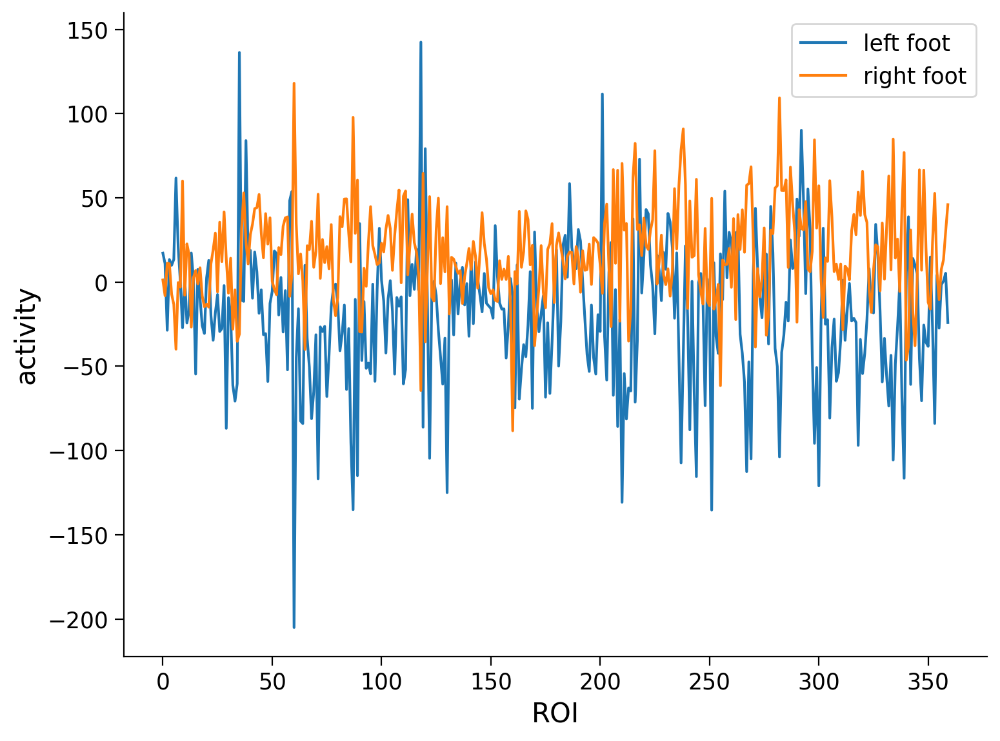

In [50]:
# Plot activity level in each ROI for both conditions
plt.plot(lf_activity,label='left foot')
plt.plot(rf_activity,label='right foot')
plt.xlabel('ROI')
plt.ylabel('activity')
plt.legend()
plt.show()

Now let's plot these activity vectors. We will also make use of the ROI names to find out which brain areas show highest activity in these conditions. But since there are so many areas, we will group them by network.

A powerful tool for organising and plotting this data is the combination of pandas and seaborn. Below is an example where we use pandas to create a table for the activity data and we use seaborn oto visualise it.





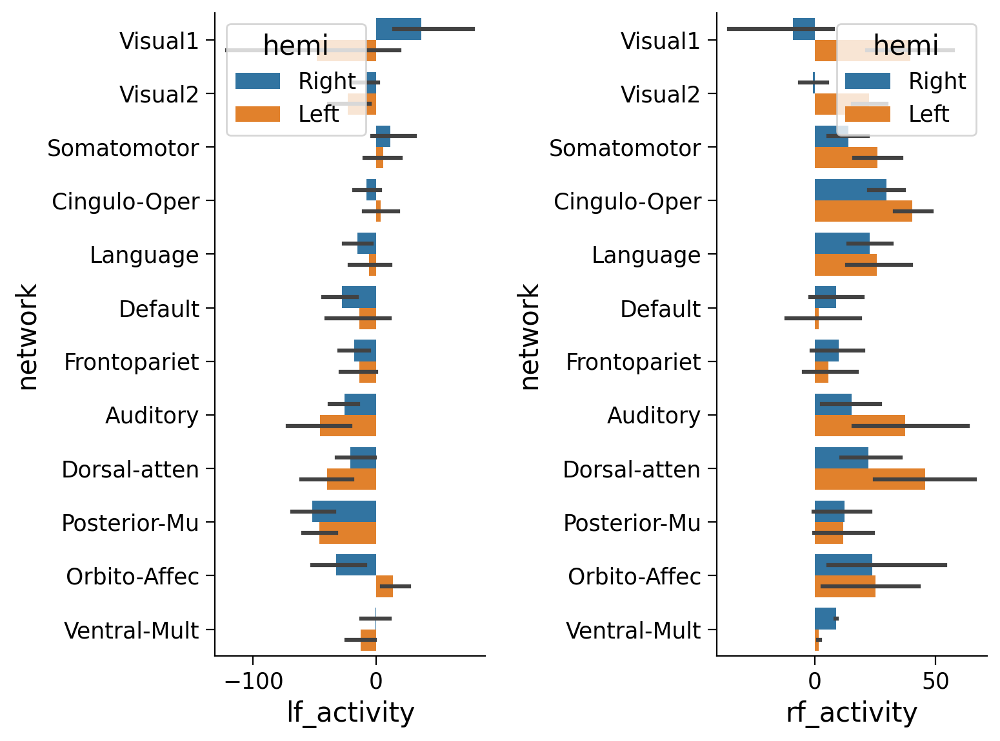

In [51]:
df = pd.DataFrame({'lf_activity' : lf_activity,
                   'rf_activity' : rf_activity,
                   'network' : region_info['network'],
                   'hemi' : region_info['hemi']})

fig, (ax1, ax2) = plt.subplots(1, 2)
sns.barplot(y='network', x='lf_activity', data=df, hue='hemi',ax=ax1)
sns.barplot(y='network', x='rf_activity', data=df, hue='hemi',ax=ax2)
plt.show()

You should be able to notice that for the somatosensory network, brain activity in the right hemi is higher for the left foot movement and vice versa for the left hemi and right foot. But this may be subtle at the single subject/session level (these are quick 3-4min scans).


Let us boost thee stats by averaging across all subjects and runs.

In [52]:
group_contrast = 0
for s in subjects:
  for r in [0, 1]:
    data = load_single_timeseries(subject=s, experiment=my_exp,
                                  run=r, remove_mean=True)
    evs = load_evs(subject=s, experiment=my_exp,run=r)

    lf_activity = average_frames(data, evs, my_exp, 'lf')
    rf_activity = average_frames(data, evs, my_exp, 'rf')

    contrast = lf_activity - rf_activity
    group_contrast += contrast

group_contrast /= (len(subjects)*2)  # remember: 2 sessions per subject

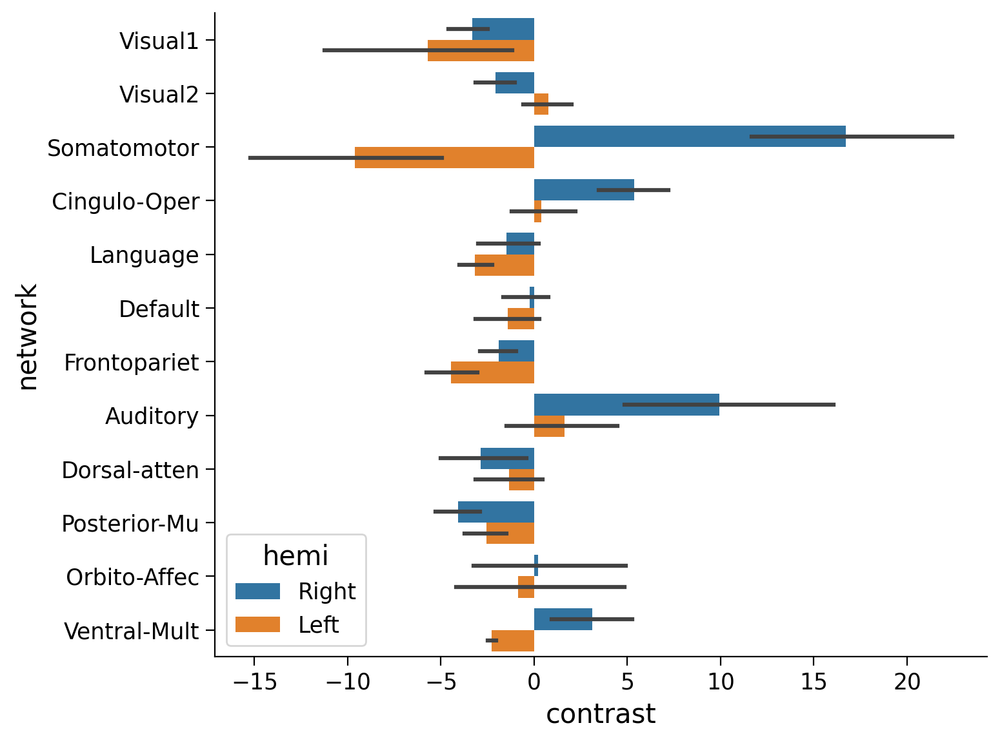

In [53]:
df = pd.DataFrame({'contrast' : group_contrast,
                   'network' : region_info['network'],
                   'hemi' : region_info['hemi']
                   })
# we will plot the left foot minus right foot contrast so we only need one plot
plt.figure()
sns.barplot(y='network', x='contrast', data=df, hue='hemi')
plt.show()

# Visualising the results on a brain

Finally, we will visualise these results on the cortical surface of an average brain.

In [54]:
# @title NMA provides an atlas. Run this cell to download it
import os, requests

# NMA provides an atlas
fname = f"{HCP_DIR}/atlas.npz"
url = "https://osf.io/j5kuc/download"

if not os.path.isfile(fname):
  try:
    r = requests.get(url)
  except requests.ConnectionError:
    print("!!! Failed to download data !!!")
  else:
    if r.status_code != requests.codes.ok:
      print("!!! Failed to download data !!!")
    else:
      with open(fname, "wb") as fid:
        fid.write(r.content)

with np.load(fname) as dobj:
  atlas = dict(**dobj)

In [75]:
# This uses the nilearn package
from nilearn import plotting, datasets

# Try both hemispheres (L->R and left->right)
fsaverage = datasets.fetch_surf_fsaverage()
surf_contrast = group_contrast[atlas["labels_L"]]
plotting.view_surf(fsaverage['infl_left'],
                   surf_contrast,
                   vmax=20)

KeyError: 'labels_L'

In [89]:
# === Surface view (left hemisphere) with fsaverage ===========================
# Uses: group_contrast (parcel values) + atlas["labels_L"] (vertex->parcel labels)
# Falls back to a demo per-vertex map if those aren’t available.

import numpy as np
from nilearn import plotting, datasets, surface

# Fetch fsaverage surfaces (lightweight)
fsaverage = datasets.fetch_surf_fsaverage()

# Try to build a per-vertex map from group_contrast and atlas["labels_L"]
surf_contrast = None
if "group_contrast" in globals() and "atlas" in globals() and "labels_L" in atlas:
    try:
        labels_L = np.asarray(atlas["labels_L"])
        gc = np.asarray(group_contrast)
        # Map parcelwise values to vertices
        surf_contrast = gc[labels_L]
    except Exception as e:
        print("Could not map group_contrast to surface; using demo sulc map instead. Reason:", e)

# Fallback: use sulcal depth as a demo map (same number of vertices)
if surf_contrast is None:
    sulc = surface.load_surf_data(fsaverage["sulc_left"])
    surf_contrast = sulc
    vmax = None
else:
    vmax = 20  # your requested cap

view = plotting.view_surf(
    fsaverage["infl_left"],
    surf_map=surf_contrast,
    vmax=vmax,
)
view  # In Colab this renders an interactive widget


/tmp/ipython-input-3452135903.py:30: DeprecationWarning: The `darkness` parameter will be deprecated in release 0.13. We recommend setting `darkness` to None
  view = plotting.view_surf(
/tmp/ipython-input-3452135903.py:30: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  view = plotting.view_surf(


In [90]:
# Mean BOLD → [-1,1] → blue↔red on 3D surfaces (interactive, version-agnostic)
import numpy as np
import nibabel as nib
from nilearn import image, datasets, surface, plotting

# 1) Get a 4D functional image from your environment (fallback: tiny demo)
func_img = None
for name in ["func_img", "epi_img", "bold_img", "fmri_img"]:
    if name in globals():
        try:
            cand = globals()[name]
            func_img = nib.load(cand) if isinstance(cand, str) else cand
            break
        except Exception:
            pass
if func_img is None:
    demo = datasets.fetch_development_fmri(n_subjects=1)
    func_img = demo.func[0]

# 2) Mean over time (raw average BOLD), then robust-normalize to [-1, 1]
mean_bold = image.mean_img(func_img)
data = mean_bold.get_fdata()
med = np.nanmedian(data)
scale = np.nanpercentile(np.abs(data - med), 99)
scale = 1.0 if (not np.isfinite(scale) or scale == 0) else scale
norm = np.clip((data - med) / scale, 0, 1.0)
norm_img = image.new_img_like(mean_bold, norm)

# 3) Project volume → surface and display (no 'view' / no 'hemispheres' args)
fsavg = datasets.fetch_surf_fsaverage()
texL = surface.vol_to_surf(norm_img, fsavg["pial_left"],  interpolation="linear")
texR = surface.vol_to_surf(norm_img, fsavg["pial_right"], interpolation="linear")

view_left  = plotting.view_surf(fsavg["infl_left"],  surf_map=texL, cmap="bwr", vmin=0, vmax=1, colorbar=True)
view_right = plotting.view_surf(fsavg["infl_right"], surf_map=texR, cmap="bwr", vmin=0, vmax=1, colorbar=True)

# Return both interactive widgets
view_left, view_right


[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri

[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri/development_fmri

[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri/development_fmri

/tmp/ipython-input-1985477811.py:21: FutureWarning: From release 0.13.0 onwards, this function will, by default, copy the header of the input image to the output. Currently, the header is reset to the default Nifti1Header. To suppress this warning and use the new behavior, set `copy_header=True`.
  mean_bold = image.mean_img(func_img)
/tmp/ipython-input-1985477811.py:34: UserWarning: Specified vmin=0 and vmax=1 values do not create a symmetric colorbar. The values will be modified to be symmetric.
  view_left  = plotting.view_surf(fsavg["infl_left"],  surf_map=texL, cmap="bwr", vmin=0, vmax=1, colorbar=True)
/tmp/ipython-input-1985477811.py:34: DeprecationWarning: The `darkness` parameter will be deprecated in release 0.13. We recommend setting `darkness` to None
  view_left  = plotting.view_surf(fsavg["infl_left"],  surf_map=texL, cmap="bwr", vmin=0, vmax=1, colorbar=True)
/tmp/ipython-input-1985477811.py:34: UserWarning: It seems you have created more than 10 nilearn views. As each v

(<nilearn.plotting.surface.html_surface.SurfaceView at 0x7f71af843c80>,
 <nilearn.plotting.surface.html_surface.SurfaceView at 0x7f71ab053830>)

In [91]:
view_left

In [92]:
# Mean BOLD → z-score across brain → blue↔red on 3D surfaces (interactive)
import numpy as np
import nibabel as nib
from nilearn import image, datasets, surface, plotting, masking

# 1) Grab a 4D functional image from your env (fallback: tiny demo)
func_img = None
for name in ["func_img", "epi_img", "bold_img", "fmri_img"]:
    if name in globals():
        try:
            cand = globals()[name]
            func_img = nib.load(cand) if isinstance(cand, str) else cand
            break
        except Exception:
            pass
if func_img is None:
    demo = datasets.fetch_development_fmri(n_subjects=1)
    func_img = demo.func[0]

# 2) Temporal mean (raw average BOLD)
mean_bold = image.mean_img(func_img)

# 3) Brain mask + spatial z-score: (voxel - μ)/σ over brain voxels
try:
    mask_img = masking.compute_epi_mask(func_img)
except Exception:
    # Fallback: compute mask from mean image if needed
    mask_img = masking.compute_epi_mask(mean_bold)
mask = mask_img.get_fdata().astype(bool)

data = mean_bold.get_fdata()
vals = data[mask]
mu = np.mean(vals)
sigma = np.std(vals, ddof=1)
sigma = 1.0 if (not np.isfinite(sigma) or sigma == 0) else sigma

zmap = (data - mu) / sigma
zmap[~mask] = np.nan  # keep background transparent
z_img = image.new_img_like(mean_bold, zmap)

# 4) Project z-map to fsaverage surfaces and display (version-agnostic)
fsavg = datasets.fetch_surf_fsaverage()
texL = surface.vol_to_surf(z_img, fsavg["pial_left"],  interpolation="linear")
texR = surface.vol_to_surf(z_img, fsavg["pial_right"], interpolation="linear")

# Choose a nice symmetric visualization range (e.g., ±3 SD)
zmax = 3.0
view_left  = plotting.view_surf(fsavg["infl_left"],  surf_map=texL, cmap="bwr", vmin=-zmax, vmax=zmax, colorbar=True)
view_right = plotting.view_surf(fsavg["infl_right"], surf_map=texR, cmap="bwr", vmin=-zmax, vmax=zmax, colorbar=True)

view_left, view_right  # interactive widgets


[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri

[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri/development_fmri

[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri/development_fmri

/tmp/ipython-input-1519085244.py:21: FutureWarning: From release 0.13.0 onwards, this function will, by default, copy the header of the input image to the output. Currently, the header is reset to the default Nifti1Header. To suppress this warning and use the new behavior, set `copy_header=True`.
  mean_bold = image.mean_img(func_img)
/usr/local/lib/python3.12/dist-packages/nilearn/surface/surface.py:603: RuntimeWarning: Mean of empty slice
  texture = np.nanmean(all_samples, axis=2)
/usr/local/lib/python3.12/dist-packages/nilearn/surface/surface.py:603: RuntimeWarning: Mean of empty slice
  texture = np.nanmean(all_samples, axis=2)
/tmp/ipython-input-1519085244.py:48: DeprecationWarning: The `darkness` parameter will be deprecated in release 0.13. We recommend setting `darkness` to None
  view_left  = plotting.view_surf(fsavg["infl_left"],  surf_map=texL, cmap="bwr", vmin=-zmax, vmax=zmax, colorbar=True)
/tmp/ipython-input-1519085244.py:48: UserWarning: It seems you have created more 

(<nilearn.plotting.surface.html_surface.SurfaceView at 0x7f71ab31f350>,
 <nilearn.plotting.surface.html_surface.SurfaceView at 0x7f71ab378290>)

In [94]:
view_left

In [132]:
# ONE BLUE REGION + TEN REGIONS (LEFT HEMI) — fixed colormaps & ranges
import numpy as np, nibabel as nib
from matplotlib import cm
from matplotlib.colors import ListedColormap
from nilearn import image, datasets, surface, plotting, masking

# --- functional image (fallback demo) ---
func_img = None
for k in ["func_img", "epi_img", "bold_img", "fmri_img"]:
    if k in globals():
        try:
            func_img = nib.load(globals()[k]) if isinstance(globals()[k], str) else globals()[k]
            break
        except Exception:
            pass
if func_img is None:
    func_img = datasets.fetch_development_fmri(n_subjects=1).func[0]

# --- mean over time → spatial z-score (across voxels) ---
mean_bold = image.mean_img(func_img)
try:
    mask_img = masking.compute_epi_mask(func_img)
except Exception:
    mask_img = masking.compute_epi_mask(mean_bold)
m = mask_img.get_fdata().astype(bool)
dat = mean_bold.get_fdata()
z = (dat - dat[m].mean()) / (dat[m].std(ddof=1) or 1.0)
z[~m] = np.nan
z_img = image.new_img_like(mean_bold, z)

# --- project to fsaverage LEFT (for background) ---
fsavg = datasets.fetch_surf_fsaverage()
texL = surface.vol_to_surf(z_img, fsavg["pial_left"], interpolation="linear")

# --- sample your atlas labels onto LEFT surface ---
assert "atlas" in globals() and "maps" in atlas, "Need atlas['maps'] (parcellation labels)."
labels_img = atlas["maps"]
labels_L = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_left"],
                                       interpolation="nearest_most_frequent")).astype(int)

# --- pick regions on LEFT ---
codes, counts = np.unique(labels_L[labels_L > 0], return_counts=True)
order = np.argsort(counts)[::-1]
if order.size == 0:
    raise RuntimeError("No labeled parcels on left hemisphere.")
lab_blue = int(codes[order[0]])               # biggest → blue
K = min(10, order.size)
labs_top = [int(codes[i]) for i in order[:K]] # top-10 → colored

print(f"BLUE code: {lab_blue}  | Top-{K} codes: {labs_top}")

# --- build overlays ---
roi_blue = np.full_like(labels_L, np.nan, float)
roi_blue[labels_L == lab_blue] = 1.0          # mark as 1

roi_10 = np.full_like(labels_L, np.nan, float)
for k, code in enumerate(labs_top, start=1):
    roi_10[labels_L == code] = float(k)       # bins 1..K

# --- show (LEFT hemisphere only) ---
zmax = 3.0
# single BLUE (use a real colormap range 0..1 to avoid vmin==vmax issues)
blue_view = plotting.view_surf(
    fsavg["infl_left"],
    surf_map=roi_blue, bg_map=texL,
    cmap=cm.get_cmap("Blues"),
    vmin=0.0, vmax=1.0,
    colorbar=False
)

# TEN regions (use tab10 with K discrete colors; center bins with 0.5 margins)
cmap_10 = ListedColormap([cm.get_cmap("tab10")(i) for i in range(K)])
ten_view = plotting.view_surf(
    fsavg["infl_left"],
    surf_map=roi_10, bg_map=texL,
    cmap=cmap_10,
    vmin=0.5, vmax=K + 0.5,
    colorbar=False
)

blue_view, ten_view


[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri

[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri/development_fmri

[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri/development_fmri

/tmp/ipython-input-1458138554.py:20: FutureWarning: From release 0.13.0 onwards, this function will, by default, copy the header of the input image to the output. Currently, the header is reset to the default Nifti1Header. To suppress this warning and use the new behavior, set `copy_header=True`.
  mean_bold = image.mean_img(func_img)
/usr/local/lib/python3.12/dist-packages/nilearn/surface/surface.py:603: RuntimeWarning: Mean of empty slice
  texture = np.nanmean(all_samples, axis=2)


BLUE code: 15  | Top-10 codes: [15, 14, 41, 32, 10, 18, 16, 28, 23, 35]


/tmp/ipython-input-1458138554.py:66: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap=cm.get_cmap("Blues"),
/tmp/ipython-input-1458138554.py:63: UserWarning: Specified vmin=0.0 and vmax=1.0 values do not create a symmetric colorbar. The values will be modified to be symmetric.
  blue_view = plotting.view_surf(
/tmp/ipython-input-1458138554.py:63: DeprecationWarning: The `darkness` parameter will be deprecated in release 0.13. We recommend setting `darkness` to None
  blue_view = plotting.view_surf(
/usr/local/lib/python3.12/dist-packages/nilearn/plotting/cm.py:49: RuntimeWarning: invalid value encountered in divide
  mix[:, color_index] = (
/usr/local/lib/python3.12/dist-packages/nilearn/plotting/_engine_utils.py:82: RuntimeWarning: invalid value encountered in cast
  colors = np.asarray(colors * 255, dtype="

(<nilearn.plotting.surface.html_surface.SurfaceView at 0x7f71a9799f70>,
 <nilearn.plotting.surface.html_surface.SurfaceView at 0x7f71b01e2690>)

In [156]:
# Plot top-K regions on LEFT hemisphere over z-scored mean-BOLD (K=2 => blue+orange)
import numpy as np, nibabel as nib
from matplotlib import cm
from matplotlib.colors import ListedColormap
from nilearn import image, datasets, surface, plotting, masking

K = 4  # <<< change this to any integer; K=2 gives blue+orange

# Reuse if available; else build quickly
try:
    fsavg, texL, labels_L
except NameError:
    # functional image (fallback demo)
    func_img = None
    for k in ["func_img", "epi_img", "bold_img", "fmri_img"]:
        if k in globals():
            try:
                func_img = nib.load(globals()[k]) if isinstance(globals()[k], str) else globals()[k]
                break
            except Exception:
                pass
    if func_img is None:
        func_img = datasets.fetch_development_fmri(n_subjects=1).func[0]

    # mean over time -> spatial z-score
    mean_bold = image.mean_img(func_img)
    try:
        mask_img = masking.compute_epi_mask(func_img)
    except Exception:
        mask_img = masking.compute_epi_mask(mean_bold)
    m = mask_img.get_fdata().astype(bool)
    dat = mean_bold.get_fdata()
    z = (dat - dat[m].mean()) / (dat[m].std(ddof=1) or 1.0)
    z[~m] = np.nan
    z_img = image.new_img_like(mean_bold, z)

    # fsaverage + project z-map to LEFT surface
    fsavg = datasets.fetch_surf_fsaverage()
    texL = surface.vol_to_surf(z_img, fsavg["pial_left"], interpolation="linear")

    # sample your atlas labels onto LEFT surface
    assert "atlas" in globals() and "maps" in atlas, "Need atlas['maps'] (parcellation labels)."
    labels_img = atlas["maps"]
    labels_L = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_left"],
                                           interpolation="nearest_most_frequent")).astype(int)

# pick top-K parcels by vertex count on LEFT
codes, counts = np.unique(labels_L[labels_L > 0], return_counts=True)
order = np.argsort(counts)[::-1]
K = int(min(K, order.size))
labs_top = [int(codes[i]) for i in order[:K]]
print(f"Top-{K} left-hemisphere label codes:", labs_top)

# build K-bin overlay (values 1..K)
roi_L = np.full_like(labels_L, np.nan, float)
for k, code in enumerate(labs_top, start=1):
    roi_L[labels_L == code] = float(k)

# palette: K=2 => blue/orange; <=10 => tab10; else tab20 recycled
if K == 1:
    cmap = ListedColormap(["#1f77b4"])
elif K == 2:
    cmap = ListedColormap(["#1f77b4", "#ff7f0e"])  # blue, orange
elif K == 4:
    cmap = ListedColormap(["white","white","#ff7f0e", "#1f77b4"])  # blue, orange
elif K <= 10:
    cmap = ListedColormap([cm.get_cmap("tab10")(i) for i in range(K)])
else:
    cmap = ListedColormap([cm.get_cmap("tab20")(i % 20) for i in range(K)])

# plot a single interactive view (LEFT)
view = plotting.view_surf(
    fsavg["infl_left"],
    surf_map=roi_L,
    bg_map=texL,          # z-scored mean-BOLD background
    cmap=cmap,
    vmin=0.5, vmax=K + 0.5,  # centered bins so colors render cleanly
    colorbar=False
)
view


Top-4 left-hemisphere label codes: [15, 14, 41, 32]


/tmp/ipython-input-1550584383.py:72: UserWarning: Specified vmin=0.5 and vmax=4.5 values do not create a symmetric colorbar. The values will be modified to be symmetric.
  view = plotting.view_surf(
/tmp/ipython-input-1550584383.py:72: DeprecationWarning: The `darkness` parameter will be deprecated in release 0.13. We recommend setting `darkness` to None
  view = plotting.view_surf(
/tmp/ipython-input-1550584383.py:72: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  view = plotting.view_surf(


In [133]:
ten_view

In [124]:
ov_right

[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri

[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri/development_fmri

[fetch_development_fmri] Dataset found in /root/nilearn_data/development_fmri/development_fmri

[fetch_atlas_schaefer_2018] Dataset found in /root/nilearn_data/schaefer_2018

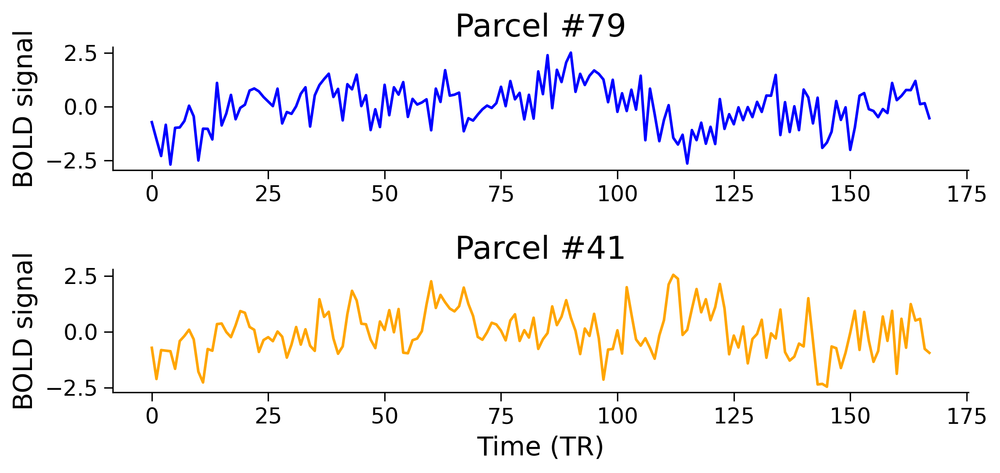

In [57]:
# === Plot two BOLD parcel time series (separate axes) ====
# Reuses existing parcellated time series if available; else extracts from a demo run.

import numpy as np
import matplotlib.pyplot as plt
from nilearn import datasets
from nilearn.maskers import NiftiLabelsMasker
import nibabel as nib

# ---- Try to find an existing (time x parcels) array in the notebook
_ts = None
for name in ["ts", "TS", "timeseries", "parcel_ts", "X", "Y", "bold_ts", "hcp_ts"]:
    if name in globals():
        arr = np.asarray(globals()[name])
        if arr.ndim == 2 and arr.shape[0] >= 20 and arr.shape[1] >= 2:
            _ts = arr
            break

# ---- If not found, try to extract from an existing functional image:
if _ts is None:
    _func = None
    for name in ["func_img", "epi_img", "bold_img", "fmri_img"]:
        if name in globals():
            try:
                _func = nib.load(globals()[name]) if isinstance(globals()[name], str) else globals()[name]
                break
            except Exception:
                pass
    if _func is None:
        # tiny demo dataset
        demo = datasets.fetch_development_fmri(n_subjects=1)
        _func = demo.func[0]

    # Use a light atlas for fast masking
    atlas = datasets.fetch_atlas_schaefer_2018(n_rois=100, yeo_networks=7, resolution_mm=2)
    masker = NiftiLabelsMasker(labels_img=atlas.maps, standardize=True, detrend=True, t_r=2.0)
    _ts = masker.fit_transform(_func)  # (time, parcels)

# ---- Pick two “active” parcels
var = _ts.var(axis=0)
idx = np.argsort(var)[-2:]
s1, s2 = _ts[:, idx[0]], _ts[:, idx[1]]

# ---- Plot
fig, axes = plt.subplots(2, 1, figsize=(8, 4), sharex=False, dpi=150)
axes[0].plot(s1, color="blue")
axes[0].set_ylabel("BOLD signal")
axes[0].set_title(f"Parcel #{int(idx[0])}")

axes[1].plot(s2, color="orange")
axes[1].set_ylabel("BOLD signal")
axes[1].set_title(f"Parcel #{int(idx[1])}")
axes[1].set_xlabel("Time (TR)")

plt.tight_layout()
plt.show()


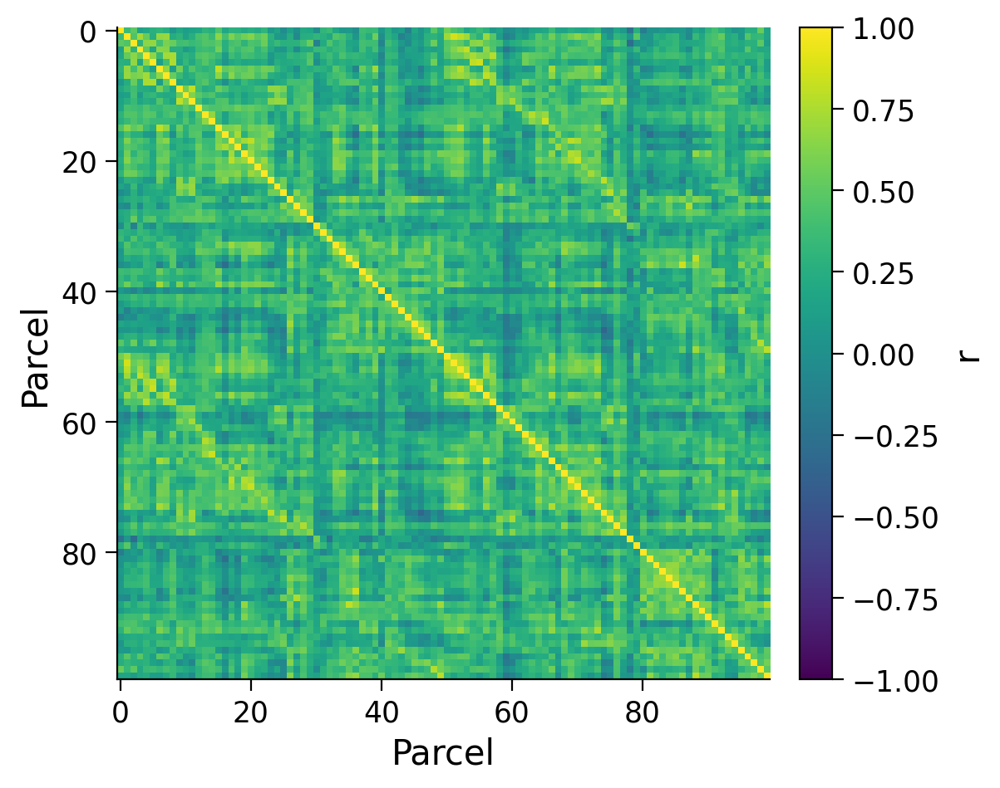

/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.canvas.print_figure(bytes_io, **kw)


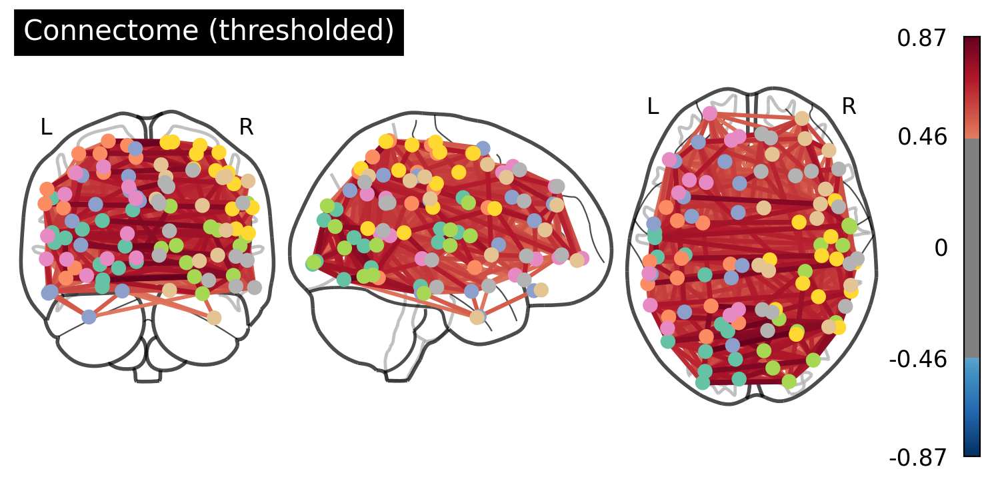

In [58]:
# === Functional connectome (Pearson across parcels) ======
# Uses the same 'ts' if available; otherwise (re)computes quickly.

import numpy as np
import matplotlib.pyplot as plt
from nilearn.connectome import ConnectivityMeasure
from nilearn import datasets, plotting
from nilearn.maskers import NiftiLabelsMasker
import nibabel as nib

# ---- Get parcel time series (time x parcels)
try:
    _ = _ts  # from previous cell
except NameError:
    _ts = None

if _ts is None:
    # Try to extract from existing func image; else demo
    _func = None
    for name in ["func_img", "epi_img", "bold_img", "fmri_img"]:
        if name in globals():
            try:
                _func = nib.load(globals()[name]) if isinstance(globals()[name], str) else globals()[name]
                break
            except Exception:
                pass
    if _func is None:
        demo = datasets.fetch_development_fmri(n_subjects=1)
        _func = demo.func[0]

    atlas = datasets.fetch_atlas_schaefer_2018(n_rois=100, yeo_networks=7, resolution_mm=2)
    masker = NiftiLabelsMasker(labels_img=atlas.maps, standardize=True, detrend=True, t_r=2.0)
    _ts = masker.fit_transform(_func)

# ---- Pearson correlation connectome
corr = ConnectivityMeasure(kind="correlation")
C = corr.fit_transform([_ts])[0]  # (parcels x parcels), diag ~ 1

# ---- Plot matrix
fig, ax = plt.subplots(figsize=(6, 5))
im = ax.imshow(C, vmin=-1, vmax=1, interpolation="nearest")
# ax.set_title("Functional connectome (Pearson r) — 1 subject")
ax.set_xlabel("Parcel")
ax.set_ylabel("Parcel")
cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label("r")
plt.tight_layout()
plt.show()

# ---- Optional: quick thresholded graph view (if we know parcel coordinates)
try:
    atlas  # may exist from above
except NameError:
    atlas = datasets.fetch_atlas_schaefer_2018(n_rois=C.shape[0], yeo_networks=7, resolution_mm=2)
try:
    coords = plotting.find_parcellation_cut_coords(labels_img=atlas.maps)
    plotting.plot_connectome(C, coords, edge_threshold="80%", title="Connectome (thresholded)")
    plotting.show()
except Exception:
    pass


In [71]:
# Build fsaverage surface labels from the atlas volume, then check parcels 41 & 79
import numpy as np, nibabel as nib
from nilearn import datasets, surface

# Need an atlas label image. In this notebook it's usually atlas["maps"].
if "atlas" in globals() and isinstance(atlas, dict) and ("maps" in atlas):
    labels_img = atlas["maps"]
elif "labels_img" in globals():
    labels_img = labels_img
else:
    raise RuntimeError("I need a parcellation label image (e.g., atlas['maps']). Run the earlier cell that builds 'atlas'.")

fsavg = datasets.fetch_surf_fsaverage()

# 1) Sample volumetric labels to fsaverage L/R surfaces
labels_L = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_left"],  interpolation="nearest")).astype(int)
labels_R = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_right"], interpolation="nearest")).astype(int)

# 2) Get the label-code ordering used by your timeseries/contrasts:
#    columns j correspond to sorted positive label codes lbl_vals[j]
lab_img_data = nib.load(labels_img).get_fdata().astype(int)
lbl_vals = np.unique(lab_img_data); lbl_vals = lbl_vals[lbl_vals > 0]; lbl_vals.sort()
code_to_idx = {int(c): i for i, c in enumerate(lbl_vals)}

# Helper: parcel index (0-based) -> label code from atlas image
idx_to_code = lambda p: int(lbl_vals[int(p)])

# 3) Where are parcels 41 & 79?
pA, pB = 41, 79
labA, labB = idx_to_code(pA), idx_to_code(pB)

cntA_L = int((labels_L == labA).sum()); cntA_R = int((labels_R == labA).sum())
cntB_L = int((labels_L == labB).sum()); cntB_R = int((labels_R == labB).sum())
print(f"Parcel {pA}: label code {labA} — LEFT {cntA_L} verts, RIGHT {cntA_R} verts")
print(f"Parcel {pB}: label code {labB} — LEFT {cntB_L} verts, RIGHT {cntB_R} verts")

# Also list some heavy hitters so you can pick a parcel that definitely shows up
def top_codes(labels, k=10):
    v, c = np.unique(labels[labels > 0], return_counts=True)
    order = np.argsort(c)[::-1]
    return [(int(v[i]), int(c[order][j])) for j, i in enumerate(order[:k])]
print("Top LEFT codes:",  top_codes(labels_L))
print("Top RIGHT codes:", top_codes(labels_R))


/tmp/ipython-input-2871021535.py:16: FutureWarning: The 'nearest' interpolation method will be deprecated in 0.13.0. To disable this warning, select either 'linear' or 'nearest_most_frequent'. If your image is a deterministic atlas 'nearest_most_frequent' is recommended. Otherwise, use 'linear'. See the documentation for more information.
  labels_L = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_left"],  interpolation="nearest")).astype(int)
/tmp/ipython-input-2871021535.py:17: FutureWarning: The 'nearest' interpolation method will be deprecated in 0.13.0. To disable this warning, select either 'linear' or 'nearest_most_frequent'. If your image is a deterministic atlas 'nearest_most_frequent' is recommended. Otherwise, use 'linear'. See the documentation for more information.
  labels_R = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_right"], interpolation="nearest")).astype(int)


Parcel 41: label code 42 — LEFT 109 verts, RIGHT 45 verts
Parcel 79: label code 80 — LEFT 0 verts, RIGHT 238 verts
Top LEFT codes: [(16, 334), (41, 327), (15, 313), (14, 280), (10, 279), (11, 267), (23, 263), (8, 259), (26, 258), (28, 256)]
Top RIGHT codes: [(70, 261), (66, 258), (76, 256), (69, 249), (78, 243), (80, 238), (53, 237), (56, 226), (60, 216), (73, 209)]


In [ ]:
# Build fsaverage surface labels from the atlas volume, then check parcels 41 & 79
import numpy as np, nibabel as nib
from nilearn import datasets, surface

# Need an atlas label image. In this notebook it's usually atlas["maps"].
if "atlas" in globals() and isinstance(atlas, dict) and ("maps" in atlas):
    labels_img = atlas["maps"]
elif "labels_img" in globals():
    labels_img = labels_img
else:
    raise RuntimeError("I need a parcellation label image (e.g., atlas['maps']). Run the earlier cell that builds 'atlas'.")

fsavg = datasets.fetch_surf_fsaverage()

# 1) Sample volumetric labels to fsaverage L/R surfaces
labels_L = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_left"],  interpolation="nearest")).astype(int)
labels_R = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_right"], interpolation="nearest")).astype(int)

# 2) Get the label-code ordering used by your timeseries/contrasts:
#    columns j correspond to sorted positive label codes lbl_vals[j]
lab_img_data = nib.load(labels_img).get_fdata().astype(int)
lbl_vals = np.unique(lab_img_data); lbl_vals = lbl_vals[lbl_vals > 0]; lbl_vals.sort()
code_to_idx = {int(c): i for i, c in enumerate(lbl_vals)}

# Helper: parcel index (0-based) -> label code from atlas image
idx_to_code = lambda p: int(lbl_vals[int(p)])

# 3) Where are parcels 41 & 79?
pA, pB = 41, 79
labA, labB = idx_to_code(pA), idx_to_code(pB)

cntA_L = int((labels_L == labA).sum()); cntA_R = int((labels_R == labA).sum())
cntB_L = int((labels_L == labB).sum()); cntB_R = int((labels_R == labB).sum())
print(f"Parcel {pA}: label code {labA} — LEFT {cntA_L} verts, RIGHT {cntA_R} verts")
print(f"Parcel {pB}: label code {labB} — LEFT {cntB_L} verts, RIGHT {cntB_R} verts")

# Also list some heavy hitters so you can pick a parcel that definitely shows up
def top_codes(labels, k=10):
    v, c = np.unique(labels[labels > 0], return_counts=True)
    order = np.argsort(c)[::-1]
    return [(int(v[i]), int(c[order][j])) for j, i in enumerate(order[:k])]
print("Top LEFT codes:",  top_codes(labels_L))
print("Top RIGHT codes:", top_codes(labels_R))


/tmp/ipython-input-2871021535.py:16: FutureWarning: The 'nearest' interpolation method will be deprecated in 0.13.0. To disable this warning, select either 'linear' or 'nearest_most_frequent'. If your image is a deterministic atlas 'nearest_most_frequent' is recommended. Otherwise, use 'linear'. See the documentation for more information.
  labels_L = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_left"],  interpolation="nearest")).astype(int)
/tmp/ipython-input-2871021535.py:17: FutureWarning: The 'nearest' interpolation method will be deprecated in 0.13.0. To disable this warning, select either 'linear' or 'nearest_most_frequent'. If your image is a deterministic atlas 'nearest_most_frequent' is recommended. Otherwise, use 'linear'. See the documentation for more information.
  labels_R = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_right"], interpolation="nearest")).astype(int)


Parcel 41: label code 42 — LEFT 109 verts, RIGHT 45 verts
Parcel 79: label code 80 — LEFT 0 verts, RIGHT 238 verts
Top LEFT codes: [(16, 334), (41, 327), (15, 313), (14, 280), (10, 279), (11, 267), (23, 263), (8, 259), (26, 258), (28, 256)]
Top RIGHT codes: [(70, 261), (66, 258), (76, 256), (69, 249), (78, 243), (80, 238), (53, 237), (56, 226), (60, 216), (73, 209)]


In [72]:
# Rebuild fsaverage labels from atlas["maps"] and make background maps
import numpy as np, nibabel as nib
from nilearn import datasets, surface

assert "atlas" in globals() and "maps" in atlas, "Need atlas['maps'] from earlier cell."
labels_img = atlas["maps"]
fsavg = datasets.fetch_surf_fsaverage()

# Use recommended interpolation for deterministic atlases
labels_L = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_left"],
                                       interpolation="nearest_most_frequent")).astype(int)
labels_R = np.rint(surface.vol_to_surf(labels_img, fsavg["pial_right"],
                                       interpolation="nearest_most_frequent")).astype(int)

# Label-code order used by your parcel vectors
lab_img_data = nib.load(labels_img).get_fdata().astype(int)
lbl_vals = np.unique(lab_img_data); lbl_vals = lbl_vals[lbl_vals > 0]; lbl_vals.sort()
code_to_idx = {int(c): i for i, c in enumerate(lbl_vals)}
idx_to_code = lambda p: int(lbl_vals[int(p)])

# Background from group_contrast (falls back to sulc if needed)
from nilearn import plotting
try:
    gc = np.asarray(group_contrast)
    idx_L = np.vectorize(lambda code: code_to_idx.get(int(code), -1))(labels_L)
    idx_R = np.vectorize(lambda code: code_to_idx.get(int(code), -1))(labels_R)
    bg_L = np.full_like(idx_L, np.nan, float); bg_R = np.full_like(idx_R, np.nan, float)
    for idx_arr, bg_arr in [(idx_L, bg_L), (idx_R, bg_R)]:
        m = idx_arr >= 0
        bg_arr[m] = gc[idx_arr[m]]
    m = float(np.nanmax(np.abs(gc))) if np.isfinite(gc).any() else 1.0
    vmin_bg, vmax_bg = -m, m
except Exception:
    from nilearn import surface
    bg_L = surface.load_surf_data(fsavg["sulc_left"])
    bg_R = surface.load_surf_data(fsavg["sulc_right"])
    vmin_bg = vmax_bg = None

print("Labels rebuilt with interpolation='nearest_most_frequent'.")


Labels rebuilt with interpolation='nearest_most_frequent'.


In [73]:
# Overlay: 41 on LEFT (blue), 79 on RIGHT (orange)
import numpy as np
from matplotlib.colors import ListedColormap
from nilearn import plotting, datasets

fsavg = datasets.fetch_surf_fsaverage()

pA, pB = 41, 79
labA, labB = idx_to_code(pA), idx_to_code(pB)

roi_L = np.full_like(labels_L, np.nan, float)
roi_R = np.full_like(labels_R, np.nan, float)
roi_L[labels_L == labA] = 1.0           # Parcel 41 -> LEFT (blue)
roi_R[labels_R == labB] = 2.0           # Parcel 79 -> RIGHT (orange)

cntA_L = int((labels_L == labA).sum()); cntB_R = int((labels_R == labB).sum())
print(f"LEFT Parcel 41 verts: {cntA_L} | RIGHT Parcel 79 verts: {cntB_R}")

cmap_bo = ListedColormap(["#1f77b4", "#ff7f0e"])

# LEFT views (only plot if any vertex selected)
views = []
if np.isfinite(roi_L).any():
    views += [
        plotting.view_surf(fsavg["infl_left"], surf_map=roi_L, bg_map=bg_L,
                           cmap=cmap_bo, vmin=1.0, vmax=2.0, colorbar=False,
                           view="lateral", darkness=0.4),
        plotting.view_surf(fsavg["infl_left"], surf_map=roi_L, bg_map=bg_L,
                           cmap=cmap_bo, vmin=1.0, vmax=2.0, colorbar=False,
                           view="medial", darkness=0.4),
    ]
# RIGHT views
if np.isfinite(roi_R).any():
    views += [
        plotting.view_surf(fsavg["infl_right"], surf_map=roi_R, bg_map=bg_R,
                           cmap=cmap_bo, vmin=1.0, vmax=2.0, colorbar=False,
                           view="lateral", darkness=0.4),
        plotting.view_surf(fsavg["infl_right"], surf_map=roi_R, bg_map=bg_R,
                           cmap=cmap_bo, vmin=1.0, vmax=2.0, colorbar=False,
                           view="medial", darkness=0.4),
    ]
views  # interactive widgets


LEFT Parcel 41 verts: 121 | RIGHT Parcel 79 verts: 294


TypeError: view_surf() got an unexpected keyword argument 'view'

In [69]:
# === Overlay: highlight parcels 41 (blue) and 79 (orange) on the same view ===
import numpy as np
from matplotlib.colors import ListedColormap
from nilearn import plotting

# Make a NaN mask everywhere except the two parcels of interest
roi_map = np.full_like(labels_L, np.nan, dtype=float)
roi_map[labels_L == 15] = 1.0   # Parcel 41 -> bin 1
roi_map[labels_L == 16] = 2.0   # Parcel 79 -> bin 2

# Discrete colormap for the two parcels (blue, orange)
roi_cmap = ListedColormap(["#1f77b4", "#ff7f0e"])  # matches Matplotlib C0/C1

# Render: group_contrast as background; ROI overlay on top
view_overlay = plotting.view_surf(
    fsaverage["infl_left"],
    surf_map=roi_map,                 # transparent where NaN
    bg_map=surf_contrast,             # your original contrast as underlay
    cmap=roi_cmap,
    vmin=1.0, vmax=2.0,               # match the bins we used above
    colorbar=False
)
view_overlay


/tmp/ipython-input-833707498.py:15: UserWarning: Specified vmin=1.0 and vmax=2.0 values do not create a symmetric colorbar. The values will be modified to be symmetric.
  view_overlay = plotting.view_surf(
/tmp/ipython-input-833707498.py:15: DeprecationWarning: The `darkness` parameter will be deprecated in release 0.13. We recommend setting `darkness` to None
  view_overlay = plotting.view_surf(
/tmp/ipython-input-833707498.py:15: UserWarning: It seems you have created more than 10 nilearn views. As each view uses dozens of megabytes of RAM, you might want to delete some of them.
  view_overlay = plotting.view_surf(


In [60]:
# --- ORIGINAL COLORING: group_contrast mapped with atlas["labels_L"] ----------
import numpy as np
from nilearn import plotting, datasets, surface

# Fetch fsaverage (left hemisphere)
fsaverage = datasets.fetch_surf_fsaverage()

# Try to build per-vertex map from group_contrast and atlas["labels_L"]
surf_contrast = None
if "group_contrast" in globals() and "atlas" in globals() and ("labels_L" in atlas):
    try:
        labels_L = np.asarray(atlas["labels_L"])
        gc = np.asarray(group_contrast)
        # Auto-handle 0-based vs 1-based labels
        if labels_L.min() >= 0 and labels_L.max() <= (len(gc)-1):
            idx = labels_L
        elif labels_L.min() >= 1 and labels_L.max() <= len(gc):
            idx = labels_L - 1
        else:
            raise ValueError("labels_L range does not match group_contrast length.")
        surf_contrast = gc[idx]
        vmax = float(np.nanpercentile(surf_contrast, 99))
    except Exception as e:
        print("Could not map group_contrast to surface; using sulcal depth instead. Reason:", e)

# Fallback: sulcal depth if needed
if surf_contrast is None:
    surf_contrast = surface.load_surf_data(fsaverage["sulc_left"])
    vmax = None

# Interactive surface (same look/feel as your prior cell)
view_orig = plotting.view_surf(
    fsaverage["infl_left"],
    surf_map=surf_contrast,
    vmax=vmax,
    colorbar=True,
    darkness=0.4
)
view_orig  # interactive widget


/tmp/ipython-input-1742464360.py:32: DeprecationWarning: The `darkness` parameter will be deprecated in release 0.13. We recommend setting `darkness` to None
  view_orig = plotting.view_surf(
